In [ ]:
# Install packages that we will use in the project
!pip install opencv-contrib-python==4.5.4.60
!pip install pypotree
!pip install open3d

In [5]:
# Import packages
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import pypotree
import open3d as o3d

ModuleNotFoundError: No module named 'cv2'

In [5]:
# Helper functions
def to_homog(points):
    """
    Function: convert points from Euclidean coordinates to homogeneous coordinates
    points: 3xn numpy array containing Euclidean coordinates
    Return: 4xn numpy array containing homogeneous coordinates
    """
    m, n = points.shape
    points_homog = np.concatenate([points, np.ones([1, n])], axis=0)
    return points_homog

def from_homog(points_homog):
    """
    Function: convert points from homogeneous coordinates to Eulidean coordinates
    points_homog: 4xn numpy array containing homogeneous coordinates
    Return: 3xn numpy array containing Euclidean coordinates
    """
    m, n = points_homog.shape
    points = points_homog[:m-1] / points_homog[m-1]
    return points

def hstack_images(img1, img2):
    """
    Function: stacks 2 images side-by-side
    img1, img2: two input images
    Return: stacked image
    """
    H = max(img1.shape[0], img2.shape[0])
    W = img1.shape[1] + img2.shape[1]
    img = np.zeros((H, W, 3), dtype=img1.dtype)
    img[:img1.shape[0], :img1.shape[1], :] = img1
    img[:img2.shape[0], img1.shape[1]:, :] = img2
    return img

def vis_correspondence(img1, img2, S1, S2):
    """
    Function: visualizes corresponding points between two images
    img1, img2: two input images
    S1: 2xn numpy array containing points in image 1
    S2: 2xn numpy array containing points in image 2 that corresponds to points in image 1
    """
    img = hstack_images(img1, img2)
    x_shift = img1.shape[1]
    S1 = S1.astype(np.int)  # Shape: [2, n].
    S2 = S2.astype(np.int)  # Shape: [2, n].
    np.random.seed(0)
    colors = np.random.rand(S1.shape[1], 3)
    if img.dtype == np.uint8:
      colors *= 255

    # Draw figure. 
    for p1, p2, color in zip(S1.T, S2.T, colors):
      x1, y1 = p1
      x2, y2 = p2
      img = cv.circle(img, (x1, y1), 5, color, -1)
      img = cv.circle(img, (x2 + x_shift, y2), 5, color, -1)
      img = cv.line(img, (x1, y1), (x2 + x_shift, y2), color, 2, cv.LINE_AA)
    plt.figure(figsize=(16, 12))
    plt.title('Visualize correspondences')
    plt.imshow(img)
    plt.show()

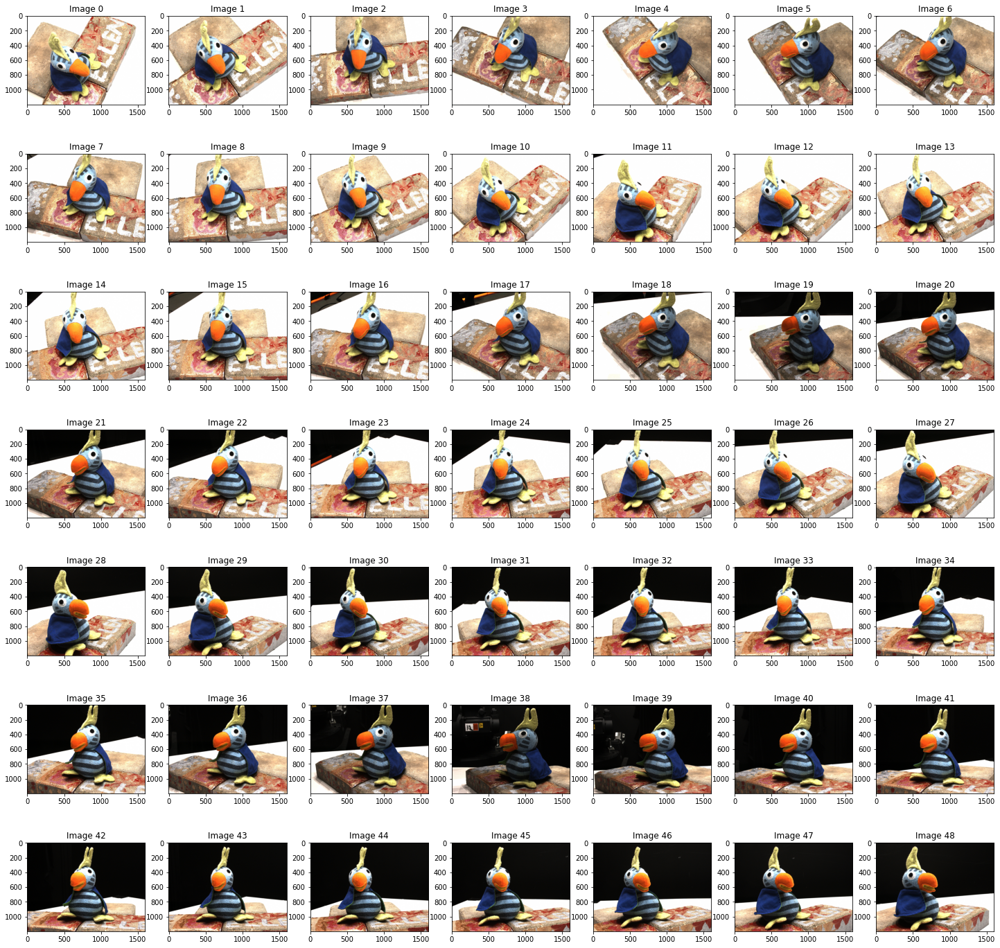

49


In [6]:
# Load images into a list
images = []
for i in range(49):
    image = cv.imread(f'./final_project_data/images/{i}.jpg') # Use cv.imread instead of plt.imread so that we can directly use cv functions afterwards
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB) # cv.imread save data in BGR order by default, change it into RGB
    images.append(image)

# Preview of images
fig = plt.figure(figsize=(25, 25))
row = 7
col = 7
for i in range(row * col):
    ax = fig.add_subplot(row, col, i+1)
    ax.title.set_text(f'Image {i}')
    plt.imshow(images[i])
plt.show()
print(len(images))

In [7]:
# Load intrinsic and extrinsic matrices
intrinsics = np.load('./final_project_data/intrinsics.npy')
extrinsics = np.load('./final_project_data/extrinsics.npy')

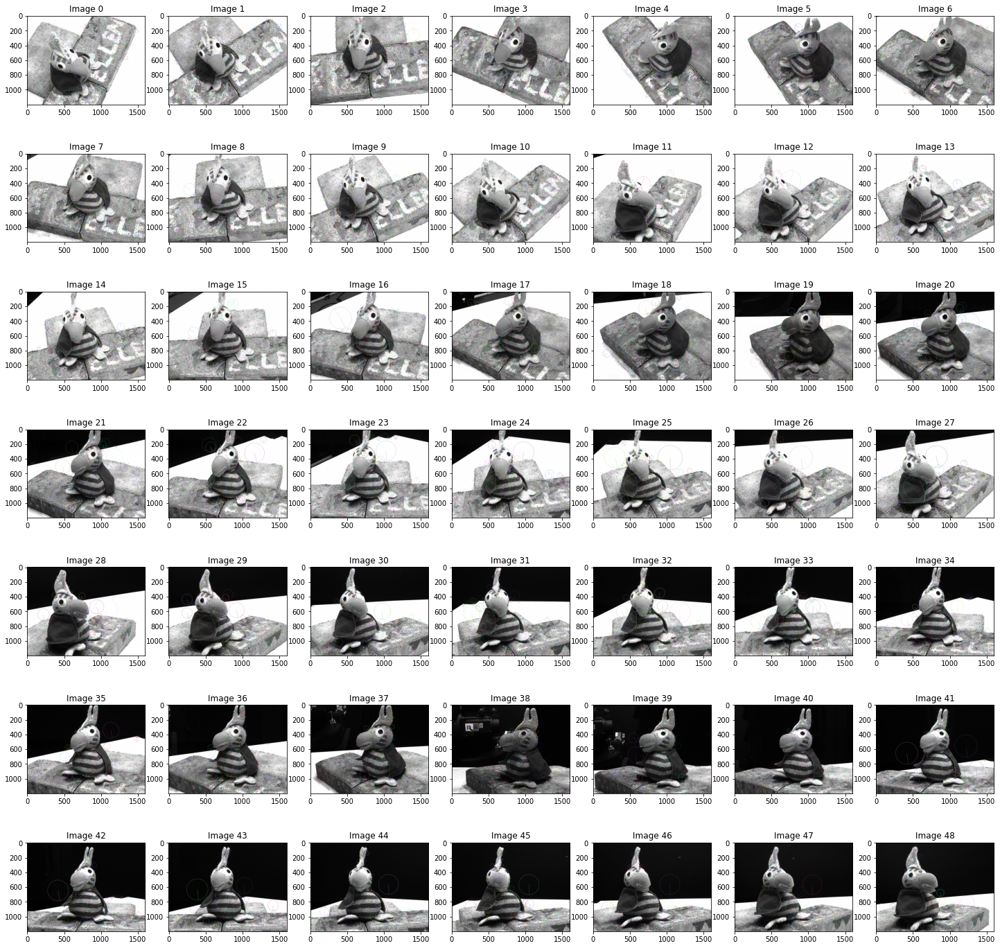

In [81]:
keypoints = []
descriptors = []
outputs = []    
for i, image in enumerate(images):
    gray_image = cv.cvtColor(image,cv.COLOR_RGB2GRAY) # Convert image to grayscale
 
    sift = cv.SIFT_create()
    kp, des = sift.detectAndCompute(gray_image,None)
    keypoints.append(kp)
    descriptors.append(des)    
    outputs.append(cv.drawKeypoints(gray_image,kp,0,
                              flags=cv.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS))
    
# Preview of images. You can use cv.drawKeypoints to generate the images with corners and visualize by plt.imshow()
fig = plt.figure(figsize=(25, 25))
row = 7
col = 7
for i in range(row * col):
    ax = fig.add_subplot(row, col, i+1)
    ax.title.set_text(f'Image {i}')
    plt.imshow(outputs[i])
plt.show()

In [82]:
def get_corresondence(img1, img2, kp1, kp2, des1, des2):
    """
    Function: get correspondence across two images
    img1, img2: two input images
    kp1, kp2: keypoints of img1 and img2
    des1, des2: descriptors of img1 and img2
    Return: two 2xn numpy array that contains corresponding points after validation
    """
 
    p1 = []
    p2 = []
    bf = cv.BFMatcher()
    matches = bf.knnMatch(des1,des2,k=2)
    for m,n in matches:
      if m.distance < 0.60*n.distance:
        p1.append(kp1[m.queryIdx].pt)
        p2.append(kp2[m.trainIdx].pt)
    pts1 = np.asarray(p1).T
    pts2 = np.asarray(p2).T
    return pts1, pts2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

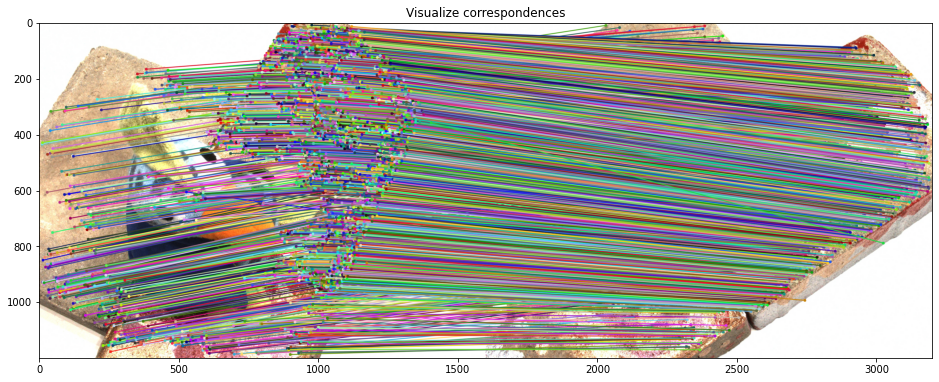

Number of correspondences derived: 2843


In [83]:
# Get corresondence of image 0 and image 1
pts1, pts2 = get_corresondence(images[0], images[1], keypoints[0], keypoints[1], descriptors[0], descriptors[1])

# Visualize correspondence
vis_correspondence(images[0], images[1], pts1, pts2)
print("Number of correspondences derived: %d" % (len(pts1[0])))

In [84]:
def reconstruct(pts1, pts2, int1, int2, ext1, ext2):
    """
    Function: reconstruct 3D points with given correspondence
    int1, int2: intrinsic matrices of camera 1 and camera 2
    ext1, ext2: extrinsic matrices of camera 1 and camera 2
    Return: 3xn numpy arrays containing the Euclidean coordinates of reconstructed 3D points
    """

    
    I_0 = np.concatenate([np.identity(3), np.zeros([3, 1])], axis=1)
    M1 = int1 @ I_0 @ ext1
    M2 = int2 @ I_0 @ ext2   
    out = cv.triangulatePoints(M1, M2, pts1, pts2, 0)  
    recon = from_homog(out)
    return recon

In [85]:
# Reconstruct 3D points
recon = reconstruct(pts1, pts2, intrinsics[0], intrinsics[1], extrinsics[0], extrinsics[1])

In [86]:
# Visualizing reconstruction results
cloudpath = pypotree.generate_cloud_for_display(-recon.T) # pypotree takes in nx3 numpy array, add negative to reverse axis
pypotree.display_cloud_colab(cloudpath)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 7b9de4 --material ELEVATION --edl-enabled --overwrite
https://localhost:24073/point_clouds/pointclouds/7b9de4


In [88]:
def validate_correspondence(pts1, pts2, int1, int2, ext1, ext2):
    """
    Function: validate corespondence via fundamental matrix
    pts1, pts2: two 2xn numpy arrays containing the original correspondence
    int1, int2: intrinsic matrices of camera 1 and camera 2
    ext1, ext2: extrinsic matrices of camera 1 and camera 2
    Return: two 2xn numpy array that contains corresponding points after validation
    """

    delta_E = ext2 @ np.linalg.inv(ext1)

    R = delta_E[:3,:3]

    t = delta_E[:3,3]

    t_cross = np.array([[0, -t[2], t[1]], 
                   [t[2], 0, -t[0]], 
                   [-t[1], t[0], 0]
                  ])

    E_new = t_cross @ R


    F = np.linalg.inv(int1.T) @ E_new @ np.linalg.inv(int2)
    
    pts1_h = to_homog(pts1).T
    pts2_h = to_homog(pts2).T

    temp1 = np.ones([2,1])
    temp2 = np.ones([2,1])

    for i in range(pts1.shape[1]):
      if (np.linalg.norm(pts1_h[i].T.reshape(-1,3) @ F @ 
                         pts2_h[i].T.reshape(3,-1))) < images[0].shape[0] * 0.01:
        p1 = from_homog(pts1_h[i].reshape(3,1))
        temp1 = np.append(temp1, p1, axis = 1)
        p2 = from_homog(pts2_h[i].reshape(3,1))
        temp2 = np.append(temp2, p2, axis = 1)
    pts1_inliers = temp1[:,1:]
    pts2_inliers = temp2[:,1:] 

    return pts1_inliers, pts2_inliers

Correspondence after validation:


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

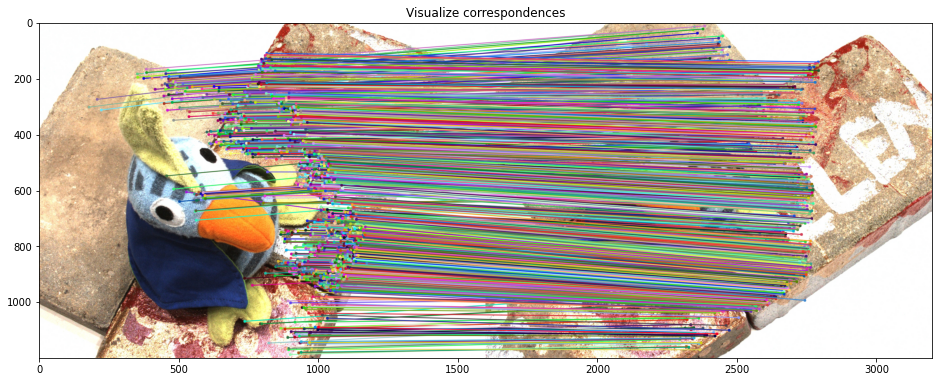

Number of correspondences after validation: 1133


In [89]:
# Validate correspondence via camera matrices
pts1_inliers, pts2_inliers = validate_correspondence(pts1, pts2, intrinsics[0], intrinsics[1], extrinsics[0], extrinsics[1])
# Visualize correspondence after validation
print("Correspondence after validation:")
vis_correspondence(images[0], images[1], pts1_inliers, pts2_inliers)
print("Number of correspondences after validation: %d" % (len(pts1_inliers[0])))

In [90]:
# Reconstruct 3D points with cleaner visualization
recon = reconstruct(pts1_inliers, pts2_inliers, intrinsics[0], intrinsics[1], extrinsics[0], extrinsics[1])

# Visualizing reconstruction results
cloudpath2 = pypotree.generate_cloud_for_display(-recon.T)
pypotree.display_cloud_colab(cloudpath2)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p db17cb --material ELEVATION --edl-enabled --overwrite
https://localhost:24073/point_clouds/pointclouds/db17cb


In [91]:
# Include the whole data set
for i in range (1, 48):
    print("Resconstructing from image %d and %d..." % (i, i+1))
    pts1, pts2 = get_corresondence(images[i], images[i+1], keypoints[i], keypoints[i+1], descriptors[i], descriptors[i+1])
    pts1_inliers, pts2_inliers = validate_correspondence(pts1, pts2, intrinsics[i], intrinsics[i+1], extrinsics[i], extrinsics[i+1])
    recon_next = reconstruct(pts1_inliers, pts2_inliers, intrinsics[i], intrinsics[1+1], extrinsics[i], extrinsics[i+1])
    recon = np.hstack([recon, recon_next])

Resconstructing from image 1 and 2...
Resconstructing from image 2 and 3...
Resconstructing from image 3 and 4...
Resconstructing from image 4 and 5...
Resconstructing from image 5 and 6...
Resconstructing from image 6 and 7...
Resconstructing from image 7 and 8...
Resconstructing from image 8 and 9...
Resconstructing from image 9 and 10...
Resconstructing from image 10 and 11...
Resconstructing from image 11 and 12...
Resconstructing from image 12 and 13...
Resconstructing from image 13 and 14...
Resconstructing from image 14 and 15...
Resconstructing from image 15 and 16...
Resconstructing from image 16 and 17...
Resconstructing from image 17 and 18...
Resconstructing from image 18 and 19...
Resconstructing from image 19 and 20...
Resconstructing from image 20 and 21...
Resconstructing from image 21 and 22...
Resconstructing from image 22 and 23...
Resconstructing from image 23 and 24...
Resconstructing from image 24 and 25...
Resconstructing from image 25 and 26...
Resconstructing f

In [95]:
# Visualizing reconstruction results
cloudpath3 = pypotree.generate_cloud_for_display(-recon.T)
pypotree.display_cloud_colab(cloudpath3)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 2dd99a --material ELEVATION --edl-enabled --overwrite
https://localhost:24073/point_clouds/pointclouds/2dd99a


In [104]:
pcd = o3d.geometry.PointCloud()
# print(recon.shape)
NpToO3d = recon.T

pcd.points = o3d.utility.Vector3dVector(NpToO3d)

cl, ind = pcd.remove_statistical_outlier(nb_neighbors=20,std_ratio=0.3)
                                                    
# print(len(ind))
o3dToNp = np.asarray(cl.points).T

In [105]:
# Visualizing reconstruction results
cloudpath4 = pypotree.generate_cloud_for_display(-o3dToNp.T)
pypotree.display_cloud_colab(cloudpath4)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 177092 --material ELEVATION --edl-enabled --overwrite
https://localhost:24073/point_clouds/pointclouds/177092


# Final output

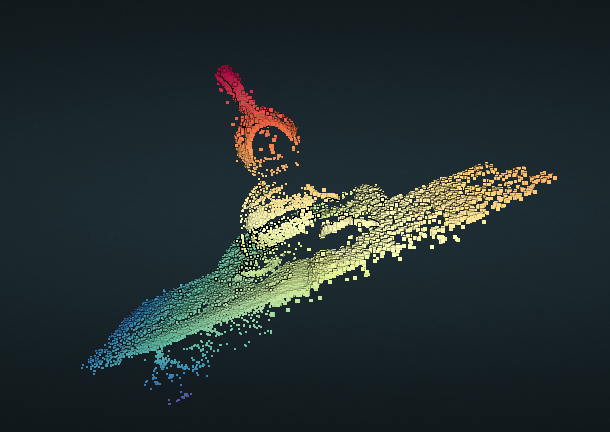